In [1]:
from transformers import CLIPProcessor, CLIPModel
from PIL import Image
import torch
import pandas as pd
import requests
from io import BytesIO
from tqdm import tqdm

import matplotlib.pyplot as plt


/Users/kate-chuprun/jewish_maps/.venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
df = pd.read_csv("photos.csv")
df_sample = df.sample(1000, random_state=42)
url_sample = df_sample['link']

images = []

for url in tqdm(url_sample):
    # download the image
    response = requests.get(url)
    image = Image.open(BytesIO(response.content))
    images.append(image)


100%|██████████| 1000/1000 [10:27<00:00,  1.59it/s]


In [11]:
texts = ["commercial service (beauty salon, hairdresser, flower shop)", "product (clothes, book, toy, handmade item, etc.)", \
         "selfie or a portrait of a person",\
         "touristic attraction or city view, architecture, building, etc.",
         "parks, nature, green, water, etc.",
         "public event, sports event, or a group of people", 
         "personal memory"]

In [12]:
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

In [13]:
inputs = processor(text=texts, images=images, return_tensors="pt", padding=True)
outputs = model(**inputs)
probs = outputs.logits_per_image.softmax(dim=1)

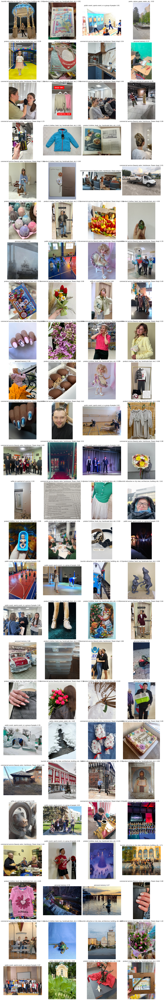

In [14]:
# show the image in the notebook
import math

n_images = min(len(images), 100)
n_cols = 4
n_rows = math.ceil(n_images / n_cols)

plt.figure(figsize=(n_cols * 5, n_rows * 5))
class_names = []

for i, image in enumerate(images):
    propability = probs[i].tolist()
    highest_prob = max(propability)
    highest_prob_index = propability.index(highest_prob)
    class_name = texts[highest_prob_index]
    class_names.append(class_name)
    if i < n_images:
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(image)

        plt.title(f"{class_name}: {highest_prob:.2f}")
    plt.axis('off')

df_sample['class'] = class_names
df_sample.to_csv('photos_with_classes.csv', index=False)
plt.tight_layout()
plt.show()
